# İş Problemi
Şirketi terk edecek müşterileri tahmin edebilecek bir makine öğrenmesi modeli geliştirilmesi beklenmektedir.

# Veri Seti Hikayesi
Telco müşteri kaybı verileri, üçüncü çeyrekte Kaliforniya'daki 7043 müşteriye ev telefonu ve İnternet hizmetleri sağlayan hayali bir telekom şirketi hakkında bilgi içerir. Hangi müşterilerin hizmetlerinden ayrıldığını, kaldığını veya hizmete kaydolduğunu gösterir.

In [1]:
# CustomerId : Müşteri İd’si
# Gender : Cinsiyet
# SeniorCitizen : Müşterinin yaşlı olup olmadığı (1, 0)
# Partner : Müşterinin bir ortağı olup olmadığı (Evet, Hayır) ? Evli olup olmama
# Dependents : Müşterinin bakmakla yükümlü olduğu kişiler olup olmadığı (Evet, Hayır) (Çocuk, anne, baba, büyükanne)
# tenure : Müşterinin şirkette kaldığı ay sayısı
# PhoneService : Müşterinin telefon hizmeti olup olmadığı (Evet, Hayır)
# MultipleLines : Müşterinin birden fazla hattı olup olmadığı (Evet, Hayır, Telefon hizmeti yok)
# InternetService : Müşterinin internet servis sağlayıcısı (DSL, Fiber optik, Hayır)
# OnlineSecurity : Müşterinin çevrimiçi güvenliğinin olup olmadığı (Evet, Hayır, İnternet hizmeti yok)
# OnlineBackup : Müşterinin online yedeğinin olup olmadığı (Evet, Hayır, İnternet hizmeti yok)
# DeviceProtection : Müşterinin cihaz korumasına sahip olup olmadığı (Evet, Hayır, İnternet hizmeti yok)
# TechSupport : Müşterinin teknik destek alıp almadığı (Evet, Hayır, İnternet hizmeti yok)
# StreamingTV : Müşterinin TV yayını olup olmadığı (Evet, Hayır, İnternet hizmeti yok) Müşterinin, bir üçüncü taraf sağlayıcıdan televizyon programları yayınlamak için İnternet hizmetini kullanıp kullanmadığını gösterir
# StreamingMovies : Müşterinin film akışı olup olmadığı (Evet, Hayır, İnternet hizmeti yok) Müşterinin bir üçüncü taraf sağlayıcıdan film akışı yapmak için İnternet hizmetini kullanıp kullanmadığını gösterir
# Contract : Müşterinin sözleşme süresi (Aydan aya, Bir yıl, İki yıl)
# PaperlessBilling : Müşterinin kağıtsız faturası olup olmadığı (Evet, Hayır)
# PaymentMethod : Müşterinin ödeme yöntemi (Elektronik çek, Posta çeki, Banka havalesi (otomatik), Kredi kartı (otomatik))
# MonthlyCharges : Müşteriden aylık olarak tahsil edilen tutar
# TotalCharges : Müşteriden tahsil edilen toplam tutar
# Churn : Müşterinin kullanıp kullanmadığı (Evet veya Hayır) - Geçen ay veya çeyreklik içerisinde ayrılan müşteriler


# Her satır benzersiz bir müşteriyi temsil etmekte.
# Değişkenler müşteri hizmetleri, hesap ve demografik veriler hakkında bilgiler içerir.
# Müşterilerin kaydolduğu hizmetler - phone, multiple lines, internet, online security, online backup, device protection, tech support, and streaming TV and movies
# Müşteri hesap bilgileri – ne kadar süredir müşteri oldukları, sözleşme, ödeme yöntemi, kağıtsız faturalandırma, aylık ücretler ve toplam ücretler
# Müşteriler hakkında demografik bilgiler - cinsiyet, yaş aralığı ve ortakları ve bakmakla yükümlü oldukları kişiler olup olmadığı

# Görev 1: Keşifçi Veri Analizi

### Adım 1:
Numerik ve kategorik değişkenleri yakalayınız.

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt

from sklearn.preprocessing import LabelEncoder, StandardScaler

from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier

from sklearn.model_selection import GridSearchCV, train_test_split, cross_validate, cross_val_score, validation_curve
from sklearn.metrics import accuracy_score, roc_auc_score, confusion_matrix, classification_report, plot_roc_curve


import warnings
warnings.simplefilter(action='ignore', category=Warning)
pd.set_option('display.max_columns', None)

In [3]:
df = pd.read_csv('/Users/mericgenc/Desktop/Python - Data Science/Miuul Data Scientist Path/06 - Machine Learning/04_advanced_trees/02_case_study_II/dataset/Telco-Customer-Churn.csv')
df.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No
2,3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
3,7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
4,9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes


In [4]:
df.tail()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
7038,6840-RESVB,Male,0,Yes,Yes,24,Yes,Yes,DSL,Yes,No,Yes,Yes,Yes,Yes,One year,Yes,Mailed check,84.80,1990.5,No
7039,2234-XADUH,Female,0,Yes,Yes,72,Yes,Yes,Fiber optic,No,Yes,Yes,No,Yes,Yes,One year,Yes,Credit card (automatic),103.20,7362.9,No
7040,4801-JZAZL,Female,0,Yes,Yes,11,No,No phone service,DSL,Yes,No,No,No,No,No,Month-to-month,Yes,Electronic check,29.60,346.45,No
7041,8361-LTMKD,Male,1,Yes,No,4,Yes,Yes,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Mailed check,74.40,306.6,Yes
7042,3186-AJIEK,Male,0,No,No,66,Yes,No,Fiber optic,Yes,No,Yes,Yes,Yes,Yes,Two year,Yes,Bank transfer (automatic),105.65,6844.5,No


In [5]:
def check_df(dataframe, head=5):
    print("##################### Shape #####################")
    print(dataframe.shape)
    print("##################### Types #####################")
    print(dataframe.dtypes)
    print("##################### NA #####################")
    print(dataframe.isnull().sum())
    print("##################### Quantiles #####################")
    print(dataframe.quantile([0, 0.05, 0.50, 0.95, 0.99, 1]).T)

In [6]:
check_df(df)

##################### Shape #####################
(7043, 21)
##################### Types #####################
customerID           object
gender               object
SeniorCitizen         int64
Partner              object
Dependents           object
tenure                int64
PhoneService         object
MultipleLines        object
InternetService      object
OnlineSecurity       object
OnlineBackup         object
DeviceProtection     object
TechSupport          object
StreamingTV          object
StreamingMovies      object
Contract             object
PaperlessBilling     object
PaymentMethod        object
MonthlyCharges      float64
TotalCharges         object
Churn                object
dtype: object
##################### NA #####################
customerID          0
gender              0
SeniorCitizen       0
Partner             0
Dependents          0
tenure              0
PhoneService        0
MultipleLines       0
InternetService     0
OnlineSecurity      0
OnlineBackup        

In [7]:
def grab_col_names(dataframe, cat_th=10, car_th=20):
    """

    Veri setindeki kategorik, numerik ve kategorik fakat kardinal değişkenlerin isimlerini verir.
    Not: Kategorik değişkenlerin içerisine numerik görünümlü kategorik değişkenler de dahildir.

    Parameters
    ------
        dataframe: dataframe
                Değişken isimleri alınmak istenilen dataframe
        cat_th: int, optional
                numerik fakat kategorik olan değişkenler için sınıf eşik değeri
        car_th: int, optinal
                kategorik fakat kardinal değişkenler için sınıf eşik değeri

    Returns
    ------
        cat_cols: list
                Kategorik değişken listesi
        num_cols: list
                Numerik değişken listesi
        cat_but_car: list
                Kategorik görünümlü kardinal değişken listesi

    Examples
    ------
        import seaborn as sns
        df = sns.load_dataset("iris")
        print(grab_col_names(df))


    Notes
    ------
        cat_cols + num_cols + cat_but_car = toplam değişken sayısı
        num_but_cat cat_cols'un içerisinde.
        Return olan 3 liste toplamı toplam değişken sayısına eşittir: cat_cols + num_cols + cat_but_car = değişken sayısı

    """
    #cat_cols, cat_but_car
    cat_cols = [col for col in dataframe.columns if dataframe[col].dtypes == 'O']
    num_but_cat = [col for col in dataframe.columns if dataframe[col].nunique() < cat_th and dataframe[col].dtypes != 'O']
    cat_but_car = [col for col in dataframe.columns if dataframe[col].nunique() > car_th and dataframe[col].dtypes == 'O']

    cat_cols = cat_cols + num_but_cat
    cat_cols = [col for col in cat_cols if col not in cat_but_car]

    #num_cols
    num_cols = [col for col in dataframe.columns if dataframe[col].dtypes != 'O']
    num_cols = [col for col in num_cols if col not in num_but_cat]

    print(f"Observations: {dataframe.shape[0]}")
    print(f"Variables: {dataframe.shape[1]}")
    print(f'cat_cols: {len(cat_cols)}')
    print(f'num_cols: {len(num_cols)}')
    print(f'cat_but_car: {len(cat_but_car)}')
    print(f'num_but_cat: {len(num_but_cat)}')
    
    return cat_cols, num_cols, cat_but_car

In [8]:
cat_cols, num_cols, cat_but_car = grab_col_names(df)

Observations: 7043
Variables: 21
cat_cols: 17
num_cols: 2
cat_but_car: 2
num_but_cat: 1


In [9]:
cat_but_car

['customerID', 'TotalCharges']

In [10]:
#Total Charges'ı float'a dönüştürmemiz gerekiyor

### Adım 2:
Gerekli düzenlemeleri yapınız. (Tip hatası olan değişkenler gibi)

In [11]:
df.TotalCharges = pd.to_numeric(df.TotalCharges, errors='coerce')

In [12]:
df.Churn = df.Churn.apply(lambda x: 1 if x=='Yes' else 0)

In [13]:
#numeric kolonları güncelleyelim
cat_cols, num_cols, cat_but_car = grab_col_names(df)

Observations: 7043
Variables: 21
cat_cols: 17
num_cols: 3
cat_but_car: 1
num_but_cat: 2


In [14]:
cat_cols

['gender',
 'Partner',
 'Dependents',
 'PhoneService',
 'MultipleLines',
 'InternetService',
 'OnlineSecurity',
 'OnlineBackup',
 'DeviceProtection',
 'TechSupport',
 'StreamingTV',
 'StreamingMovies',
 'Contract',
 'PaperlessBilling',
 'PaymentMethod',
 'SeniorCitizen',
 'Churn']

In [15]:
num_cols

['tenure', 'MonthlyCharges', 'TotalCharges']

In [16]:
df['SeniorCitizen'].unique()

array([0, 1])

### Adım 3:
Numerik ve kategorik değişkenlerin veri içindeki dağılımını gözlemleyiniz.

In [17]:
def cat_summary(dataframe, col_name, plot=False):
    print(pd.DataFrame({col_name: dataframe[col_name].value_counts(),
        'Ratio': 100*dataframe[col_name].value_counts()/len(dataframe)}))
    print('########################################################')
    if plot:
        sns.countplot(x=dataframe[col_name], data=dataframe)
        plt.show()

In [18]:
for col in cat_cols:
    cat_summary(df, col)

        gender     Ratio
Male      3555  50.47565
Female    3488  49.52435
########################################################
     Partner     Ratio
No      3641  51.69672
Yes     3402  48.30328
########################################################
     Dependents      Ratio
No         4933  70.041176
Yes        2110  29.958824
########################################################
     PhoneService      Ratio
Yes          6361  90.316626
No            682   9.683374
########################################################
                  MultipleLines      Ratio
No                         3390  48.132898
Yes                        2971  42.183729
No phone service            682   9.683374
########################################################
             InternetService      Ratio
Fiber optic             3096  43.958540
DSL                     2421  34.374556
No                      1526  21.666903
########################################################
              

In [19]:
def num_summary(dataframe, numerical_col, plot=False):
    quantiles = [0.05, 0.10, 0.20, 0.30, 0.40, 0.50, 0.60, 0.70, 0.80, 0.90, 0.95, 0.99]
    print(dataframe[numerical_col].describe(quantiles).T)

    if plot:
        dataframe[numerical_col].hist(bins=20)
        plt.xlabel(numerical_col)
        plt.title(numerical_col)
        plt.show(block=True)

count    7043.000000
mean       32.371149
std        24.559481
min         0.000000
5%          1.000000
10%         2.000000
20%         6.000000
30%        12.000000
40%        20.000000
50%        29.000000
60%        40.000000
70%        50.000000
80%        60.000000
90%        69.000000
95%        72.000000
99%        72.000000
max        72.000000
Name: tenure, dtype: float64


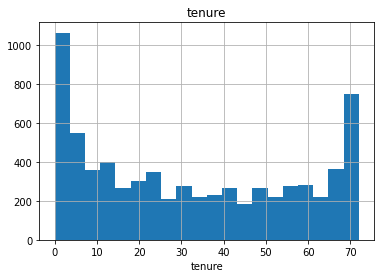

count    7043.000000
mean       64.761692
std        30.090047
min        18.250000
5%         19.650000
10%        20.050000
20%        25.050000
30%        45.850000
40%        58.830000
50%        70.350000
60%        79.100000
70%        85.500000
80%        94.250000
90%       102.600000
95%       107.400000
99%       114.729000
max       118.750000
Name: MonthlyCharges, dtype: float64


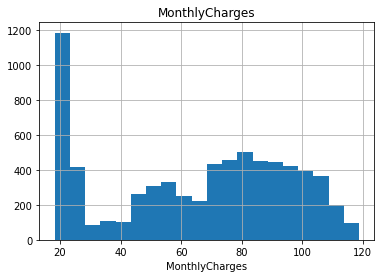

count    7032.000000
mean     2283.300441
std      2266.771362
min        18.800000
5%         49.605000
10%        84.600000
20%       267.070000
30%       551.995000
40%       944.170000
50%      1397.475000
60%      2048.950000
70%      3141.130000
80%      4475.410000
90%      5976.640000
95%      6923.590000
99%      8039.883000
max      8684.800000
Name: TotalCharges, dtype: float64


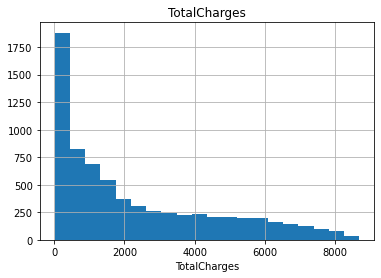

In [20]:
for col in num_cols:
    num_summary(df, col, True)

### Adım 4:
Kategorik değişkenler ile hedef değişken incelemesini yapınız.

In [21]:
def target_summary_with_cat(dataframe, target, categorical_col):
    print(categorical_col)
    print(pd.DataFrame({"TARGET_MEAN": dataframe.groupby(categorical_col)[target].mean(),
                        "Count": dataframe[categorical_col].value_counts(),
                        "Ratio": 100 * dataframe[categorical_col].value_counts() / len(dataframe)}), end="\n\n\n")

In [22]:
for col in cat_cols:
    target_summary_with_cat(df, "Churn", col)

gender
        TARGET_MEAN  Count     Ratio
Female     0.269209   3488  49.52435
Male       0.261603   3555  50.47565


Partner
     TARGET_MEAN  Count     Ratio
No      0.329580   3641  51.69672
Yes     0.196649   3402  48.30328


Dependents
     TARGET_MEAN  Count      Ratio
No      0.312791   4933  70.041176
Yes     0.154502   2110  29.958824


PhoneService
     TARGET_MEAN  Count      Ratio
No      0.249267    682   9.683374
Yes     0.267096   6361  90.316626


MultipleLines
                  TARGET_MEAN  Count      Ratio
No                   0.250442   3390  48.132898
No phone service     0.249267    682   9.683374
Yes                  0.286099   2971  42.183729


InternetService
             TARGET_MEAN  Count      Ratio
DSL             0.189591   2421  34.374556
Fiber optic     0.418928   3096  43.958540
No              0.074050   1526  21.666903


OnlineSecurity
                     TARGET_MEAN  Count      Ratio
No                      0.417667   3498  49.666335
No internet ser

In [23]:
def target_summary_with_num(dataframe, target, numerical_col):
    print(dataframe.groupby(target).agg({numerical_col: "mean"}), end="\n\n\n")

In [24]:
for col in num_cols:
    target_summary_with_num(df, 'Churn', col)

          tenure
Churn           
0      37.569965
1      17.979133


       MonthlyCharges
Churn                
0           61.265124
1           74.441332


       TotalCharges
Churn              
0       2555.344141
1       1531.796094




In [25]:
# Korelasyon

In [26]:
df[num_cols].corr()

,tenure,MonthlyCharges,TotalCharges
tenure,1.00000,0.247900,0.825880
MonthlyCharges,0.24790,1.000000,0.651065
TotalCharges,0.82588,0.651065,1.000000


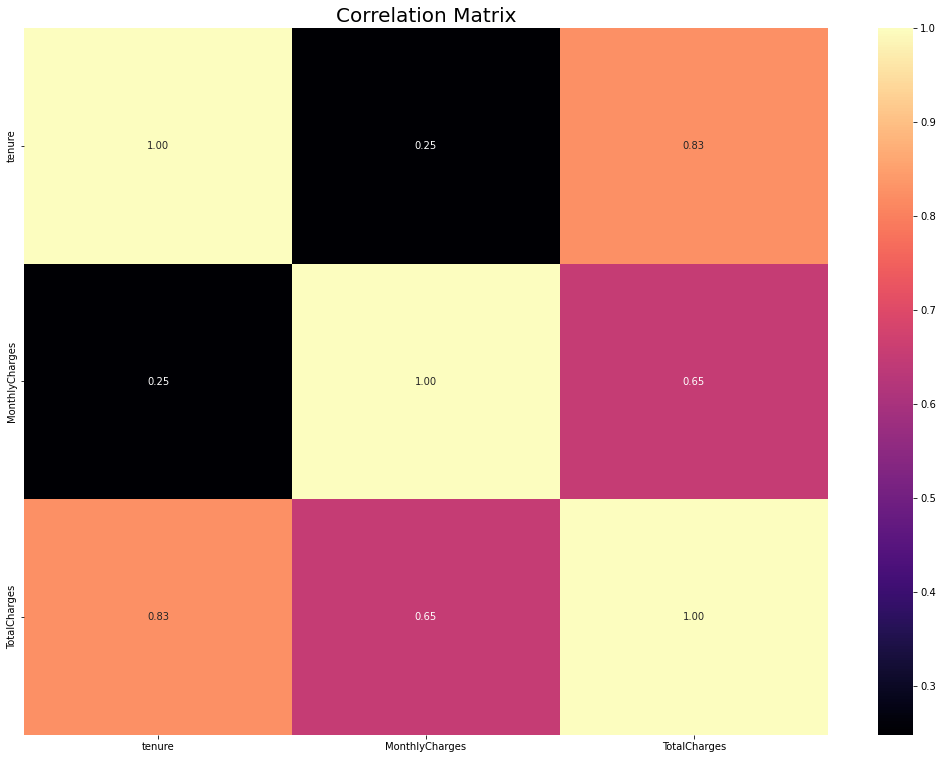

In [27]:
f, ax = plt.subplots(figsize=[18, 13])
sns.heatmap(df[num_cols].corr(), annot=True, fmt=".2f", ax=ax, cmap="magma")
ax.set_title("Correlation Matrix", fontsize=20)
plt.show()

In [28]:
df.corrwith(df["Churn"]).sort_values(ascending=False)

Churn             1.000000
MonthlyCharges    0.193356
SeniorCitizen     0.150889
TotalCharges     -0.199484
tenure           -0.352229
dtype: float64

### Adım 5:
Aykırı gözlem var mı inceleyiniz.

In [29]:
def outlier_thresholds(dataframe, col_name, q1=0.25, q3=0.75):
    quartile1 = dataframe[col_name].quantile(q1)
    quartile3 = dataframe[col_name].quantile(q3)
    interquartile_range = quartile3 - quartile1
    up_limit = quartile3 + 1.5 * interquartile_range
    low_limit = quartile1 - 1.5 * interquartile_range
    return low_limit, up_limit

In [30]:
def check_outlier(dataframe, col_name):
    low_limit, up_limit = outlier_thresholds(dataframe, col_name)
    if dataframe[(dataframe[col_name]>up_limit) | (dataframe[col_name]<low_limit)].any(axis=None):
        return True
    else:
        return False

In [31]:
num_cols

['tenure', 'MonthlyCharges', 'TotalCharges']

In [32]:
for col in num_cols:
    print(check_outlier(df, col))

False
False
False


### Adım 6:
Eksik gözlem var mı inceleyiniz.

In [33]:
df.isnull().sum()

customerID           0
gender               0
SeniorCitizen        0
Partner              0
Dependents           0
tenure               0
PhoneService         0
MultipleLines        0
InternetService      0
OnlineSecurity       0
OnlineBackup         0
DeviceProtection     0
TechSupport          0
StreamingTV          0
StreamingMovies      0
Contract             0
PaperlessBilling     0
PaymentMethod        0
MonthlyCharges       0
TotalCharges        11
Churn                0
dtype: int64

# Görev 2: Feature Engineering

### Adım 1:
Eksik ve aykırı gözlemler için gerekli işlemleri yapınız.

In [34]:
#Eksik verileri medyan değer ile dolduruyoruz;

In [35]:
df['TotalCharges'].fillna(df['TotalCharges'].median(), inplace=True)

In [36]:
df.isnull().sum()

customerID          0
gender              0
SeniorCitizen       0
Partner             0
Dependents          0
tenure              0
PhoneService        0
MultipleLines       0
InternetService     0
OnlineSecurity      0
OnlineBackup        0
DeviceProtection    0
TechSupport         0
StreamingTV         0
StreamingMovies     0
Contract            0
PaperlessBilling    0
PaymentMethod       0
MonthlyCharges      0
TotalCharges        0
Churn               0
dtype: int64

In [37]:
#Aykırı gözlem yok

### Adım 2:
Yeni değişkenler oluşturunuz.

In [38]:
df.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,0
1,5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.50,0
2,3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,1
3,7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,0
4,9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,1


In [39]:
df.loc[(df['tenure']>=0) & (df['tenure']<=12), 'NEW_Tenure_Year'] = '0-1 Year'
df.loc[(df['tenure']>12) & (df['tenure']<=24), 'NEW_Tenure_Year'] = '1-2 Year'
df.loc[(df['tenure']>24) & (df['tenure']<=36), 'NEW_Tenure_Year'] = '2-3 Year'
df.loc[(df['tenure']>36) & (df['tenure']<=48), 'NEW_Tenure_Year'] = '3-4 Year'
df.loc[(df['tenure']>48) & (df['tenure']<=60), 'NEW_Tenure_Year'] = '5-6 Year'
df.loc[(df['tenure']>60) & (df['tenure']<=72), 'NEW_Tenure_Year'] = '6-7 Year'

In [40]:
df.Contract.unique()

array(['Month-to-month', 'One year', 'Two year'], dtype=object)

In [41]:
df['NEW_Engaged'] = df['Contract'].apply(lambda x: 1 if x in ['One year', 'Two year'] else 0)

In [42]:
df["NEW_noProt"] = df.apply(lambda x: 1 if (x["OnlineSecurity"] != "Yes") or (x["OnlineBackup"] != "Yes") or (x["DeviceProtection"] != "Yes") or (x["TechSupport"] != "Yes") else 0, axis=1)

In [43]:
df["NEW_Young_Not_Engaged"] = df.apply(lambda x: 1 if (x["NEW_Engaged"] == 0) and (x["SeniorCitizen"] == 0) else 0, axis=1)

In [44]:
df['NEW_TotalServices'] = (df[['PhoneService', 'InternetService', 'OnlineSecurity',
                                       'OnlineBackup', 'DeviceProtection', 'TechSupport',
                                       'StreamingTV', 'StreamingMovies']]== 'Yes').sum(axis=1)

In [45]:
df["NEW_FLAG_ANY_STREAMING"] = df.apply(lambda x: 1 if (x["StreamingTV"] == "Yes") or (x["StreamingMovies"] == "Yes") else 0, axis=1)

In [46]:
df["NEW_FLAG_AutoPayment"] = df["PaymentMethod"].apply(lambda x: 1 if x in ["Bank transfer (automatic)","Credit card (automatic)"] else 0)

In [47]:
df["NEW_AVG_Charges"] = df["TotalCharges"] / (df["tenure"] + 1)

In [48]:
df["NEW_Increase"] = df["NEW_AVG_Charges"] / df["MonthlyCharges"]

In [49]:
df["NEW_AVG_Service_Fee"] = df["MonthlyCharges"] / (df['NEW_TotalServices'] + 1)

In [50]:
df.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn,NEW_Tenure_Year,NEW_Engaged,NEW_noProt,NEW_Young_Not_Engaged,NEW_TotalServices,NEW_FLAG_ANY_STREAMING,NEW_FLAG_AutoPayment,NEW_AVG_Charges,NEW_Increase,NEW_AVG_Service_Fee
0,7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,0,0-1 Year,0,1,1,1,0,0,14.925000,0.500000,14.9250
1,5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.50,0,2-3 Year,1,1,0,3,0,0,53.985714,0.947949,14.2375
2,3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,1,0-1 Year,0,1,1,3,0,0,36.050000,0.669452,13.4625
3,7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,0,3-4 Year,1,1,0,3,0,1,40.016304,0.946012,10.5750
4,9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,1,0-1 Year,0,1,1,1,0,0,50.550000,0.714993,35.3500


In [51]:
df.shape

(7043, 31)

### Adım 3:
Encoding işlemlerini gerçekleştiriniz.

In [52]:
cat_cols, num_cols, cat_but_car = grab_col_names(df)

Observations: 7043
Variables: 31
cat_cols: 24
num_cols: 6
cat_but_car: 1
num_but_cat: 8


In [53]:
le = LabelEncoder()

In [54]:
binary_cols = [col for col in df.columns if df[col].dtypes == 'O' and df[col].nunique() == 2]

In [55]:
binary_cols

['gender', 'Partner', 'Dependents', 'PhoneService', 'PaperlessBilling']

In [56]:
for col in binary_cols:
    df[col] = le.fit_transform(df[col])

In [57]:
cat_cols = [col for col in cat_cols if col not in binary_cols and col not in ['Churn','NEW_TotalServices']]

In [58]:
df = pd.get_dummies(df, columns=cat_cols, drop_first=True)

In [59]:
df.head()

,customerID,gender,Partner,Dependents,tenure,PhoneService,PaperlessBilling,MonthlyCharges,TotalCharges,Churn,NEW_TotalServices,NEW_AVG_Charges,NEW_Increase,NEW_AVG_Service_Fee,MultipleLines_No phone service,MultipleLines_Yes,InternetService_Fiber optic,InternetService_No,OnlineSecurity_No internet service,OnlineSecurity_Yes,OnlineBackup_No internet service,OnlineBackup_Yes,DeviceProtection_No internet service,DeviceProtection_Yes,TechSupport_No internet service,TechSupport_Yes,StreamingTV_No internet service,StreamingTV_Yes,StreamingMovies_No internet service,StreamingMovies_Yes,Contract_One year,Contract_Two year,PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,PaymentMethod_Mailed check,NEW_Tenure_Year_1-2 Year,NEW_Tenure_Year_2-3 Year,NEW_Tenure_Year_3-4 Year,NEW_Tenure_Year_5-6 Year,NEW_Tenure_Year_6-7 Year,SeniorCitizen_1,NEW_Engaged_1,NEW_noProt_1,NEW_Young_Not_Engaged_1,NEW_FLAG_ANY_STREAMING_1,NEW_FLAG_AutoPayment_1
0,7590-VHVEG,0,1,0,1,0,1,29.85,29.85,0,1,14.925000,0.500000,14.9250,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0
1,5575-GNVDE,1,0,0,34,1,0,56.95,1889.50,0,3,53.985714,0.947949,14.2375,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,1,1,0,0,0
2,3668-QPYBK,1,0,0,2,1,1,53.85,108.15,1,3,36.050000,0.669452,13.4625,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0
3,7795-CFOCW,1,0,0,45,0,0,42.30,1840.75,0,3,40.016304,0.946012,10.5750,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,1,0,0,1
4,9237-HQITU,0,0,0,2,1,1,70.70,151.65,1,1,50.550000,0.714993,35.3500,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0


### Adım 4:
Numerik değişkenler için standartlaştırma yapınız.

In [60]:
num_cols

['tenure',
 'MonthlyCharges',
 'TotalCharges',
 'NEW_AVG_Charges',
 'NEW_Increase',
 'NEW_AVG_Service_Fee']

In [61]:
ss = StandardScaler()

In [62]:
df[num_cols] = ss.fit_transform(df[num_cols])

In [63]:
df[num_cols]

,tenure,MonthlyCharges,TotalCharges,NEW_AVG_Charges,NEW_Increase,NEW_AVG_Service_Fee
0,-1.277445,-1.160323,-0.994242,-0.757979,-0.237662,-0.311205
1,0.066327,-0.259629,-0.173244,-0.117801,-0.010353,-0.410396
2,-1.236724,-0.362660,-0.959674,-0.411755,-0.151674,-0.522211
3,0.514251,-0.746535,-0.194766,-0.346750,-0.011336,-0.938812
4,-1.236724,0.197365,-0.940470,-0.174110,-0.128565,2.635661
...,...,...,...,...,...,...
7038,-0.340876,0.665992,-0.128655,0.302327,-0.014937,-0.716728
7039,1.613701,1.277533,2.243151,0.650463,0.004562,0.017026
7040,-0.870241,-1.168632,-0.854469,-0.529417,0.003560,-0.329240
7041,-1.155283,0.320338,-0.872062,0.002402,-0.073152,2.902574


# Görev 3: Modelleme

### Adım 1:
Sınıflandırma algoritmaları ile modeller kurup, accuracy skorlarını inceleyip. En iyi 4 modeli seçiniz.

In [64]:
y = df['Churn']
X = df.drop(['Churn','customerID'], axis=1)

In [65]:
models = [('LR', LogisticRegression(random_state=12345)),
          ('KNN', KNeighborsClassifier()),
          ('CART', DecisionTreeClassifier(random_state=12345)),
          ('RF', RandomForestClassifier(random_state=12345)),
          ('XGB', XGBClassifier(random_state=12345)),
          ("LightGBM", LGBMClassifier(random_state=12345)),
          ("CatBoost", CatBoostClassifier(verbose=False, random_state=12345))]

In [66]:
df_models = pd.DataFrame(columns=["name", "accuracy", "auc", "recall", "precision", "f1"])

for name, model in models:
    cv_results = cross_validate(model, X, y, cv=10, scoring=["accuracy", "f1", "roc_auc", "precision", "recall"])
    df_models = df_models.append({"name": name,
                    "accuracy": round(cv_results['test_accuracy'].mean(), 4),
                    "auc": round(cv_results['test_roc_auc'].mean(), 4),
                    "recall": round(cv_results['test_recall'].mean(), 4),
                    "precision": round(cv_results['test_precision'].mean(), 4),
                    "f1": round(cv_results['test_f1'].mean(), 4)}, ignore_index=True)


In [67]:
df_models.sort_values('auc', ascending=False)

,name,accuracy,auc,recall,precision,f1
0,LR,0.8072,0.8497,0.5324,0.6738,0.5942
6,CatBoost,0.7987,0.8411,0.5238,0.6501,0.58
5,LightGBM,0.7971,0.8362,0.5286,0.6447,0.5805
3,RF,0.7945,0.8283,0.5035,0.6456,0.5653
4,XGB,0.7883,0.8275,0.5158,0.6221,0.5637
1,KNN,0.7669,0.782,0.5217,0.5665,0.543
2,CART,0.7255,0.6556,0.5035,0.4835,0.4932


### Adım 2:
Seçtiğiniz modeller ile hiperparametre optimizasyonu gerçekleştirin ve bulduğunuz hiparparametreler ile modeli tekrar kurunuz.

### Logistic Regression

In [68]:
log_model = LogisticRegression().fit(X,y)

In [69]:
cv_results = cross_validate(log_model, X, y, cv=10, scoring=["accuracy", "f1", "roc_auc", "precision", "recall"])

In [70]:
df_scores = pd.DataFrame(columns=["name", "accuracy", "auc", "recall", "precision", "f1"])

In [71]:
df_models = df_models.append({"name": 'log_model',
                    "accuracy": round(cv_results['test_accuracy'].mean(), 4),
                    "auc": round(cv_results['test_roc_auc'].mean(), 4),
                    "recall": round(cv_results['test_recall'].mean(), 4),
                    "precision": round(cv_results['test_precision'].mean(), 4),
                    "f1": round(cv_results['test_f1'].mean(), 4)}, ignore_index=True)

df_models.sort_values('auc', ascending=False)


,name,accuracy,auc,recall,precision,f1
0,LR,0.8072,0.8497,0.5324,0.6738,0.5942
7,log_model,0.8072,0.8497,0.5324,0.6738,0.5942
6,CatBoost,0.7987,0.8411,0.5238,0.6501,0.58
5,LightGBM,0.7971,0.8362,0.5286,0.6447,0.5805
3,RF,0.7945,0.8283,0.5035,0.6456,0.5653
4,XGB,0.7883,0.8275,0.5158,0.6221,0.5637
1,KNN,0.7669,0.782,0.5217,0.5665,0.543
2,CART,0.7255,0.6556,0.5035,0.4835,0.4932


### CatBoost

In [80]:
catboost_model = CatBoostClassifier()

In [81]:
catboost_params = {"iterations": [200, 500, 600, 700, 750, 800, 900, 1000],
                   "learning_rate": [0.01, 0.1],
                   "depth": [2,3,4,5,6]}

In [82]:
catboost_best_grid = GridSearchCV(catboost_model, catboost_params, cv=5, n_jobs=-1, verbose=True).fit(X, y)

Fitting 5 folds for each of 80 candidates, totalling 400 fits
0:	learn: 0.6879869	total: 3.11ms	remaining: 619ms
1:	learn: 0.6828038	total: 5.02ms	remaining: 497ms
2:	learn: 0.6783583	total: 5.98ms	remaining: 392ms
3:	learn: 0.6728993	total: 6.9ms	remaining: 338ms
4:	learn: 0.6681713	total: 7.84ms	remaining: 306ms
5:	learn: 0.6629702	total: 8.81ms	remaining: 285ms
6:	learn: 0.6578263	total: 9.76ms	remaining: 269ms
7:	learn: 0.6530762	total: 10.8ms	remaining: 260ms
8:	learn: 0.6480497	total: 11.9ms	remaining: 252ms
0:	learn: 0.6870810	total: 3.27ms	remaining: 651ms
0:	learn: 0.6880222	total: 2.35ms	remaining: 467ms
1:	learn: 0.6819029	total: 4.32ms	remaining: 428ms
9:	learn: 0.6431276	total: 13.6ms	remaining: 259ms
10:	learn: 0.6385655	total: 14.6ms	remaining: 251ms
2:	learn: 0.6761717	total: 5.75ms	remaining: 378ms
1:	learn: 0.6818760	total: 4.65ms	remaining: 461ms
3:	learn: 0.6709125	total: 6.84ms	remaining: 335ms
11:	learn: 0.6340706	total: 17.1ms	remaining: 267ms
2:	learn: 0.6761532

In [84]:
catboost_best_grid.best_params_

{'depth': 3, 'iterations': 200, 'learning_rate': 0.1}

In [85]:
catboost_final = catboost_model.set_params(**catboost_best_grid.best_params_).fit(X, y)

0:	learn: 0.6416146	total: 2.21ms	remaining: 441ms
1:	learn: 0.5958830	total: 4.15ms	remaining: 411ms
2:	learn: 0.5591063	total: 5.59ms	remaining: 367ms
3:	learn: 0.5373431	total: 7.09ms	remaining: 347ms
4:	learn: 0.5136156	total: 8.45ms	remaining: 330ms
5:	learn: 0.4948411	total: 10.4ms	remaining: 336ms
6:	learn: 0.4847618	total: 13.2ms	remaining: 363ms
7:	learn: 0.4739326	total: 15ms	remaining: 359ms
8:	learn: 0.4647872	total: 16.3ms	remaining: 345ms
9:	learn: 0.4595440	total: 17.5ms	remaining: 332ms
10:	learn: 0.4533111	total: 19.3ms	remaining: 332ms
11:	learn: 0.4491973	total: 20.7ms	remaining: 324ms
12:	learn: 0.4448016	total: 22ms	remaining: 316ms
13:	learn: 0.4414014	total: 23.3ms	remaining: 310ms
14:	learn: 0.4380241	total: 25.2ms	remaining: 310ms
15:	learn: 0.4346849	total: 27.6ms	remaining: 317ms
16:	learn: 0.4322306	total: 29.3ms	remaining: 316ms
17:	learn: 0.4307160	total: 30.9ms	remaining: 312ms
18:	learn: 0.4286112	total: 32.1ms	remaining: 306ms
19:	learn: 0.4270271	total

In [86]:
cv_results = cross_validate(catboost_final, X, y, cv=10, scoring=["accuracy", "f1", "roc_auc", "precision", "recall"])

0:	learn: 0.6448430	total: 1.32ms	remaining: 262ms
1:	learn: 0.5999337	total: 2.44ms	remaining: 242ms
2:	learn: 0.5624345	total: 4ms	remaining: 262ms
3:	learn: 0.5332241	total: 5.5ms	remaining: 270ms
4:	learn: 0.5140472	total: 6.94ms	remaining: 271ms
5:	learn: 0.5004143	total: 8.09ms	remaining: 262ms
6:	learn: 0.4901094	total: 9.19ms	remaining: 253ms
7:	learn: 0.4769243	total: 10.4ms	remaining: 250ms
8:	learn: 0.4688410	total: 11.6ms	remaining: 246ms
9:	learn: 0.4611055	total: 13.6ms	remaining: 259ms
10:	learn: 0.4563603	total: 14.8ms	remaining: 254ms
11:	learn: 0.4505939	total: 16.2ms	remaining: 254ms
12:	learn: 0.4461995	total: 17.6ms	remaining: 253ms
13:	learn: 0.4421137	total: 18.8ms	remaining: 250ms
14:	learn: 0.4383404	total: 20.1ms	remaining: 249ms
15:	learn: 0.4345541	total: 21.5ms	remaining: 247ms
16:	learn: 0.4319536	total: 22.9ms	remaining: 246ms
17:	learn: 0.4292934	total: 24.3ms	remaining: 246ms
18:	learn: 0.4264240	total: 25.8ms	remaining: 245ms
19:	learn: 0.4253078	total

In [87]:
df_models = df_models.append({"name": 'catboost_final',
                    "accuracy": round(cv_results['test_accuracy'].mean(), 4),
                    "auc": round(cv_results['test_roc_auc'].mean(), 4),
                    "recall": round(cv_results['test_recall'].mean(), 4),
                    "precision": round(cv_results['test_precision'].mean(), 4),
                    "f1": round(cv_results['test_f1'].mean(), 4)}, ignore_index=True)

df_models.sort_values('auc', ascending=False)


,name,accuracy,auc,recall,precision,f1
0,LR,0.8072,0.8497,0.5324,0.6738,0.5942
7,log_model,0.8072,0.8497,0.5324,0.6738,0.5942
8,catboost_final,0.8055,0.8463,0.5174,0.6748,0.5853
6,CatBoost,0.7987,0.8411,0.5238,0.6501,0.58
5,LightGBM,0.7971,0.8362,0.5286,0.6447,0.5805
3,RF,0.7945,0.8283,0.5035,0.6456,0.5653
4,XGB,0.7883,0.8275,0.5158,0.6221,0.5637
1,KNN,0.7669,0.782,0.5217,0.5665,0.543
2,CART,0.7255,0.6556,0.5035,0.4835,0.4932


In [88]:
def val_curve_params(model, X, y, param_name, param_range, scoring="roc_auc", cv=10):
    train_score, test_score = validation_curve(
        model, X=X, y=y, param_name=param_name, param_range=param_range, scoring=scoring, cv=cv)

    mean_train_score = np.mean(train_score, axis=1)
    mean_test_score = np.mean(test_score, axis=1)

    plt.plot(param_range, mean_train_score,
             label="Training Score", color='b')

    plt.plot(param_range, mean_test_score,
             label="Validation Score", color='g')

    plt.title(f"Validation Curve for {type(model).__name__}")
    plt.xlabel(f"Number of {param_name}")
    plt.ylabel(f"{scoring}")
    plt.tight_layout()
    plt.legend(loc='best')
    plt.show(block=True)

0:	learn: 0.6524952	total: 1.36ms	remaining: 271ms
1:	learn: 0.6198375	total: 2.92ms	remaining: 289ms
2:	learn: 0.5867003	total: 4.19ms	remaining: 275ms
3:	learn: 0.5614392	total: 5.03ms	remaining: 247ms
4:	learn: 0.5473852	total: 5.98ms	remaining: 233ms
5:	learn: 0.5357092	total: 7.54ms	remaining: 244ms
6:	learn: 0.5263410	total: 8.4ms	remaining: 232ms
7:	learn: 0.5160848	total: 9.82ms	remaining: 236ms
8:	learn: 0.5083489	total: 10.7ms	remaining: 227ms
9:	learn: 0.4979930	total: 11.6ms	remaining: 220ms
10:	learn: 0.4929050	total: 12.4ms	remaining: 214ms
11:	learn: 0.4878729	total: 13.3ms	remaining: 208ms
12:	learn: 0.4811642	total: 14.1ms	remaining: 203ms
13:	learn: 0.4769873	total: 15.2ms	remaining: 201ms
14:	learn: 0.4740354	total: 16.1ms	remaining: 199ms
15:	learn: 0.4706718	total: 17.2ms	remaining: 198ms
16:	learn: 0.4676809	total: 18.7ms	remaining: 201ms
17:	learn: 0.4652324	total: 19.7ms	remaining: 199ms
18:	learn: 0.4631919	total: 20.5ms	remaining: 195ms
19:	learn: 0.4612792	to

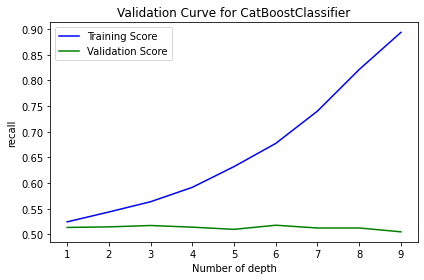

In [89]:
val_curve_params(catboost_final, X, y, 'depth', range(1, 10), scoring='recall')

0:	learn: 0.6448430	total: 1.18ms	remaining: 117ms
1:	learn: 0.5999337	total: 2.46ms	remaining: 121ms
2:	learn: 0.5624345	total: 3.73ms	remaining: 121ms
3:	learn: 0.5332241	total: 5.17ms	remaining: 124ms
4:	learn: 0.5140472	total: 6.17ms	remaining: 117ms
5:	learn: 0.5004143	total: 7.24ms	remaining: 113ms
6:	learn: 0.4901094	total: 8.52ms	remaining: 113ms
7:	learn: 0.4769243	total: 9.68ms	remaining: 111ms
8:	learn: 0.4688410	total: 11ms	remaining: 111ms
9:	learn: 0.4611055	total: 12.3ms	remaining: 111ms
10:	learn: 0.4563603	total: 13.6ms	remaining: 110ms
11:	learn: 0.4505939	total: 14.9ms	remaining: 109ms
12:	learn: 0.4461995	total: 16.4ms	remaining: 110ms
13:	learn: 0.4421137	total: 17.5ms	remaining: 107ms
14:	learn: 0.4383404	total: 18.8ms	remaining: 106ms
15:	learn: 0.4345541	total: 20.1ms	remaining: 106ms
16:	learn: 0.4319536	total: 21.6ms	remaining: 105ms
17:	learn: 0.4292934	total: 23ms	remaining: 105ms
18:	learn: 0.4264240	total: 24.5ms	remaining: 104ms
19:	learn: 0.4253078	total

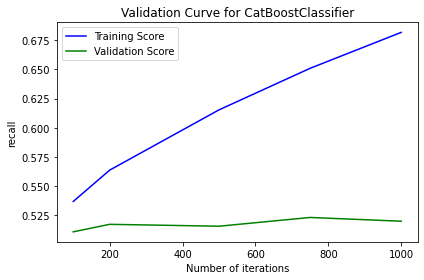

In [90]:
val_curve_params(catboost_final, X, y, 'iterations', [100,200,500,750,1000], scoring='recall')

In [91]:
def plot_importance(model, features, num=len(X), save=False):
    feature_imp = pd.DataFrame({'Value': model.feature_importances_, 'Feature': features.columns})
    plt.figure(figsize=(10, 10))
    sns.set(font_scale=1)
    sns.barplot(x="Value", y="Feature", data=feature_imp.sort_values(by="Value",
                                                                     ascending=False)[0:num])
    plt.title('Features')
    plt.tight_layout()
    plt.show()
    if save:
        plt.savefig('importances.png')

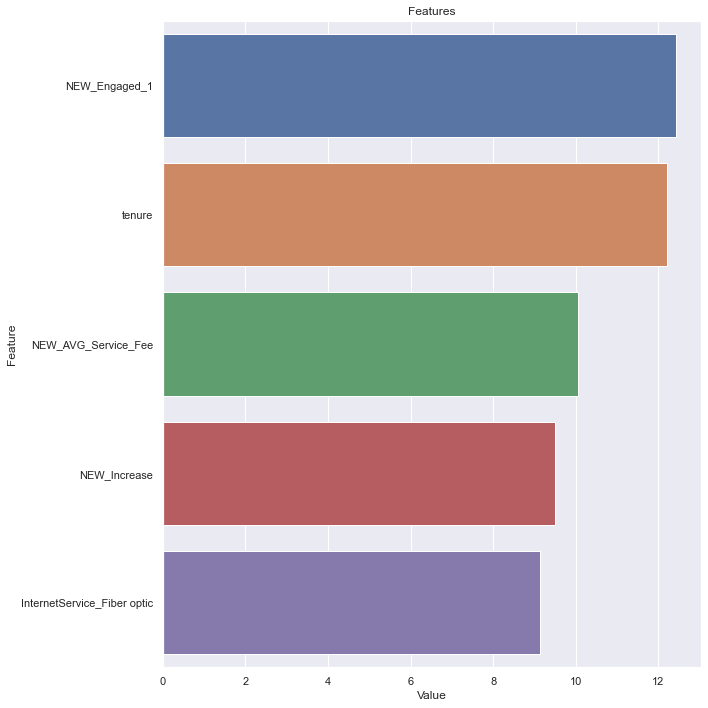

In [92]:
plot_importance(catboost_final, X, 5)

### LightGBM

In [93]:
lightgbm_model = LGBMClassifier()

In [94]:
lightgbm_model.get_params()

{'boosting_type': 'gbdt',
 'class_weight': None,
 'colsample_bytree': 1.0,
 'importance_type': 'split',
 'learning_rate': 0.1,
 'max_depth': -1,
 'min_child_samples': 20,
 'min_child_weight': 0.001,
 'min_split_gain': 0.0,
 'n_estimators': 100,
 'n_jobs': -1,
 'num_leaves': 31,
 'objective': None,
 'random_state': None,
 'reg_alpha': 0.0,
 'reg_lambda': 0.0,
 'silent': True,
 'subsample': 1.0,
 'subsample_for_bin': 200000,
 'subsample_freq': 0}

In [95]:
lightgbm_params = {"n_estimators": [200, 500, 600, 700, 750, 800, 900, 1000],
                   "learning_rate": [0.01, 0.1],
                   "max_depth": [2,3,4,5,6]}

In [96]:
lightgbm_grid = GridSearchCV(lightgbm_model, lightgbm_params, cv=5, n_jobs=-1, verbose=True).fit(X, y)

Fitting 5 folds for each of 80 candidates, totalling 400 fits
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accurac

In [97]:
lightgbm_grid.best_params_

{'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 900}

In [98]:
lightgbm_final = lightgbm_model.set_params(**lightgbm_grid.best_params_).fit(X,y)

In [99]:
cv_results = cross_validate(lightgbm_final, X, y, cv=10, scoring=["accuracy", "f1", "roc_auc", "precision", "recall"])

In [100]:
df_models = df_models.append({"name": 'lightgbm_final',
                    "accuracy": round(cv_results['test_accuracy'].mean(), 4),
                    "auc": round(cv_results['test_roc_auc'].mean(), 4),
                    "recall": round(cv_results['test_recall'].mean(), 4),
                    "precision": round(cv_results['test_precision'].mean(), 4),
                    "f1": round(cv_results['test_f1'].mean(), 4)}, ignore_index=True)

df_models.sort_values('auc', ascending=False)


,name,accuracy,auc,recall,precision,f1
0,LR,0.8072,0.8497,0.5324,0.6738,0.5942
7,log_model,0.8072,0.8497,0.5324,0.6738,0.5942
8,catboost_final,0.8055,0.8463,0.5174,0.6748,0.5853
9,lightgbm_final,0.8022,0.8459,0.5217,0.6619,0.5831
6,CatBoost,0.7987,0.8411,0.5238,0.6501,0.58
5,LightGBM,0.7971,0.8362,0.5286,0.6447,0.5805
3,RF,0.7945,0.8283,0.5035,0.6456,0.5653
4,XGB,0.7883,0.8275,0.5158,0.6221,0.5637
1,KNN,0.7669,0.782,0.5217,0.5665,0.543
2,CART,0.7255,0.6556,0.5035,0.4835,0.4932


[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^m

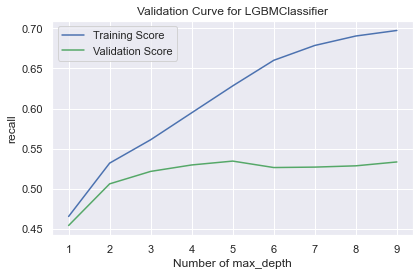

In [101]:
val_curve_params(lightgbm_final, X, y, 'max_depth', range(1, 10), scoring='recall')

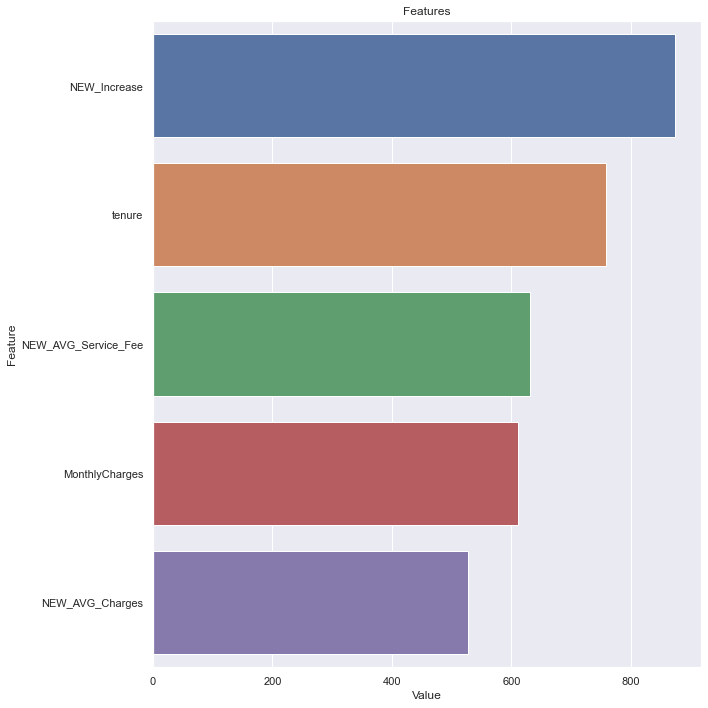

In [102]:
plot_importance(lightgbm_final, X, 5)

### XGBoost

In [103]:
xgb_model = XGBClassifier()

In [104]:
xgb_model.get_params()

{'objective': 'binary:logistic',
 'use_label_encoder': False,
 'base_score': None,
 'booster': None,
 'callbacks': None,
 'colsample_bylevel': None,
 'colsample_bynode': None,
 'colsample_bytree': None,
 'early_stopping_rounds': None,
 'enable_categorical': False,
 'eval_metric': None,
 'gamma': None,
 'gpu_id': None,
 'grow_policy': None,
 'importance_type': None,
 'interaction_constraints': None,
 'learning_rate': None,
 'max_bin': None,
 'max_cat_to_onehot': None,
 'max_delta_step': None,
 'max_depth': None,
 'max_leaves': None,
 'min_child_weight': None,
 'missing': nan,
 'monotone_constraints': None,
 'n_estimators': 100,
 'n_jobs': None,
 'num_parallel_tree': None,
 'predictor': None,
 'random_state': None,
 'reg_alpha': None,
 'reg_lambda': None,
 'sampling_method': None,
 'scale_pos_weight': None,
 'subsample': None,
 'tree_method': None,
 'validate_parameters': None,
 'verbosity': None}

In [105]:
#xgb_params = {"learning_rate": [0.1, 0.01, 0.02, 0.05],
#                  "max_depth": [1,2,3,4,5,6,7,8, None],
#                  "n_estimators": [100, 150, 200, 250, 300, 400, 500, 1000, 2000, 3000, 5000, 7500, 10000],
#                  "colsample_bytree": [None, 0.5, 0.7, 1]}

In [106]:
xgb_params = {"learning_rate": [0.1, 0.01],
                  "max_depth": [3,4,5,6,None],
                  "n_estimators": [100, 200, 300, 400],
                  "colsample_bytree": [None, 0.5, 0.7, 1]}

In [107]:
xgboost_best_grid = GridSearchCV(xgb_model, xgb_params, cv=5, n_jobs=-1, verbose=True).fit(X, y)

Fitting 5 folds for each of 160 candidates, totalling 800 fits


In [108]:
xgboost_best_grid.best_params_

{'colsample_bytree': None,
 'learning_rate': 0.01,
 'max_depth': 5,
 'n_estimators': 400}

In [109]:
xgb_final = xgb_model.set_params(**xgboost_best_grid.best_params_).fit(X, y)

In [110]:
xgb_final.get_params()

{'objective': 'binary:logistic',
 'use_label_encoder': False,
 'base_score': 0.5,
 'booster': 'gbtree',
 'callbacks': None,
 'colsample_bylevel': 1,
 'colsample_bynode': 1,
 'colsample_bytree': 1,
 'early_stopping_rounds': None,
 'enable_categorical': False,
 'eval_metric': None,
 'gamma': 0,
 'gpu_id': -1,
 'grow_policy': 'depthwise',
 'importance_type': None,
 'interaction_constraints': '',
 'learning_rate': 0.01,
 'max_bin': 256,
 'max_cat_to_onehot': 4,
 'max_delta_step': 0,
 'max_depth': 5,
 'max_leaves': 0,
 'min_child_weight': 1,
 'missing': nan,
 'monotone_constraints': '()',
 'n_estimators': 400,
 'n_jobs': 0,
 'num_parallel_tree': 1,
 'predictor': 'auto',
 'random_state': 0,
 'reg_alpha': 0,
 'reg_lambda': 1,
 'sampling_method': 'uniform',
 'scale_pos_weight': 1,
 'subsample': 1,
 'tree_method': 'exact',
 'validate_parameters': 1,
 'verbosity': None}

In [111]:
xgb_params2 = {"n_estimators": [400, 500, 600, 700, 800, 1000]}

In [112]:
xgboost_best_grid = GridSearchCV(xgb_final, xgb_params2, cv=5, n_jobs=-1, verbose=True).fit(X, y)

Fitting 5 folds for each of 6 candidates, totalling 30 fits


In [113]:
xgboost_best_grid.best_params_

{'n_estimators': 400}

In [114]:
cv_results = cross_validate(xgb_final, X, y, cv=5, scoring=["accuracy", "precision", "recall", "f1", "roc_auc"])

In [115]:
df_models = df_models.append({"name": 'xgb_final',
                    "accuracy": round(cv_results['test_accuracy'].mean(), 4),
                    "auc": round(cv_results['test_roc_auc'].mean(), 4),
                    "recall": round(cv_results['test_recall'].mean(), 4),
                    "precision": round(cv_results['test_precision'].mean(), 4),
                    "f1": round(cv_results['test_f1'].mean(), 4)}, ignore_index=True)

df_models.sort_values('auc', ascending=False)


,name,accuracy,auc,recall,precision,f1
0,LR,0.8072,0.8497,0.5324,0.6738,0.5942
7,log_model,0.8072,0.8497,0.5324,0.6738,0.5942
8,catboost_final,0.8055,0.8463,0.5174,0.6748,0.5853
9,lightgbm_final,0.8022,0.8459,0.5217,0.6619,0.5831
10,xgb_final,0.8029,0.8442,0.5292,0.6607,0.5876
6,CatBoost,0.7987,0.8411,0.5238,0.6501,0.58
5,LightGBM,0.7971,0.8362,0.5286,0.6447,0.5805
3,RF,0.7945,0.8283,0.5035,0.6456,0.5653
4,XGB,0.7883,0.8275,0.5158,0.6221,0.5637
1,KNN,0.7669,0.782,0.5217,0.5665,0.543


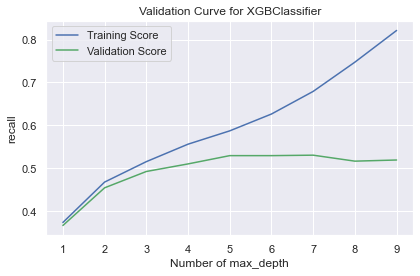

In [116]:
val_curve_params(xgb_final, X, y, 'max_depth', range(1, 10), scoring='recall')

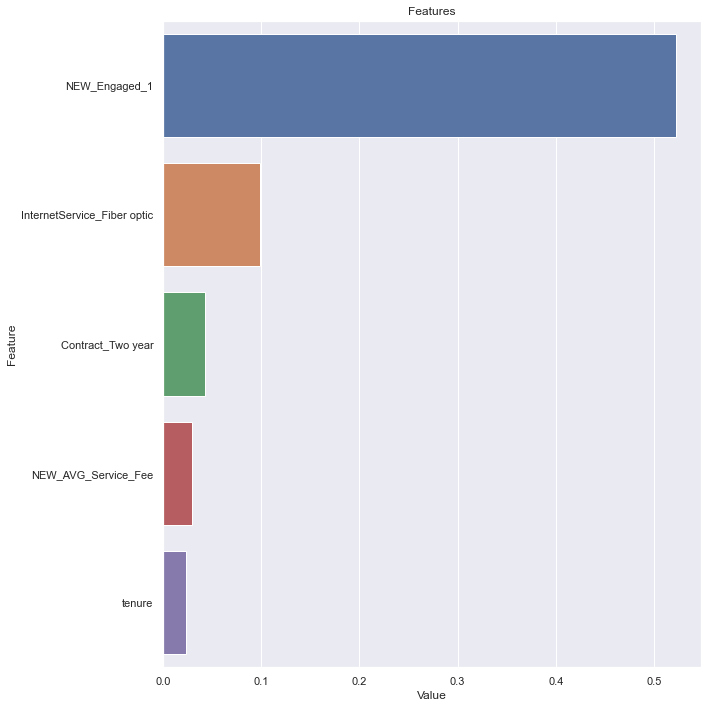

In [117]:
plot_importance(xgb_final, X, 5)

In [118]:
df_models.sort_values('auc', ascending=False)

,name,accuracy,auc,recall,precision,f1
0,LR,0.8072,0.8497,0.5324,0.6738,0.5942
7,log_model,0.8072,0.8497,0.5324,0.6738,0.5942
8,catboost_final,0.8055,0.8463,0.5174,0.6748,0.5853
9,lightgbm_final,0.8022,0.8459,0.5217,0.6619,0.5831
10,xgb_final,0.8029,0.8442,0.5292,0.6607,0.5876
6,CatBoost,0.7987,0.8411,0.5238,0.6501,0.58
5,LightGBM,0.7971,0.8362,0.5286,0.6447,0.5805
3,RF,0.7945,0.8283,0.5035,0.6456,0.5653
4,XGB,0.7883,0.8275,0.5158,0.6221,0.5637
1,KNN,0.7669,0.782,0.5217,0.5665,0.543
